In [1]:
import re
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [8]:
df = pd.read_csv('listings.csv')

In [ ]:
#example file path for local device
df = pd.read_csv(r'C:\\User\\Downloads\\listings.csv')

In [9]:
df.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,1419,https://www.airbnb.com/rooms/1419,20250609011800,2025-06-18,previous scrape,Beautiful home in amazing area!,"This large, family home is located in one of T...",The apartment is located in the Ossington stri...,https://a0.muscache.com/pictures/76206750/d643...,1565,...,5.00,5.00,5.00,NaN,f,1,1,0,0,0.05
1,8077,https://www.airbnb.com/rooms/8077,20250609011800,2025-06-18,previous scrape,Downtown Harbourfront Private Room,Guest room in a luxury condo with access to al...,NaN,https://a0.muscache.com/pictures/11780344/141c...,22795,...,4.90,4.92,4.83,NaN,f,2,1,1,0,0.88
2,26654,https://www.airbnb.com/rooms/26654,20250609011800,2025-06-18,city scrape,"World Class @ CN Tower, convention centre, The...","CN Tower, TIFF Bell Lightbox, Metro Convention...",There's a reason they call it the Entertainmen...,https://a0.muscache.com/pictures/81811785/5dcd...,113345,...,4.78,4.87,4.69,NaN,f,4,4,0,0,0.26
3,27423,https://www.airbnb.com/rooms/27423,20250609011800,2025-06-18,previous scrape,Executive Studio Unit- Ideal for One Person,"Brand new, fully furnished studio basement apa...",NaN,https://a0.muscache.com/pictures/176936/b687ed...,118124,...,5.00,4.88,4.88,NaN,f,1,1,0,0,0.17
4,30931,https://www.airbnb.com/rooms/30931,20250609011800,2025-06-18,previous scrape,Downtown Toronto - Waterview Condo,Split level waterfront condo with a breathtaki...,NaN,https://a0.muscache.com/pictures/227971/e8ebd7...,22795,...,NaN,NaN,NaN,NaN,f,2,1,1,0,0.01


In [10]:
df_explore = df.copy()

In [12]:
df_explore.shape

(21092, 79)

In [13]:
df_explore.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21092 entries, 0 to 21091
Data columns (total 79 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            21092 non-null  int64  
 1   listing_url                                   21092 non-null  object 
 2   scrape_id                                     21092 non-null  int64  
 3   last_scraped                                  21092 non-null  object 
 4   source                                        21092 non-null  object 
 5   name                                          21092 non-null  object 
 6   description                                   20686 non-null  object 
 7   neighborhood_overview                         9588 non-null   object 
 8   picture_url                                   21092 non-null  object 
 9   host_id                                       21092 non-null 

In [14]:
pd.set_option('display.max_columns', None)

In [15]:
df_explore.sample(10)

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,availability_eoy,number_of_reviews_ly,estimated_occupancy_l365d,estimated_revenue_l365d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
15532,1149926554491207872,https://www.airbnb.com/rooms/1149926554491207872,20250609011800,2025-06-18,city scrape,Downtown Condo with Stunning View & Gym -Yorkv...,Enjoy staying in downtown Toronto in the famou...,NaN,https://a0.muscache.com/pictures/prohost-api/H...,278326851,https://www.airbnb.com/users/show/278326851,Wasan,2019-07-22,"Toronto, Canada",I love hosting and will go the extra mile for ...,within an hour,100%,100%,t,https://a0.muscache.com/im/pictures/user/d5dbc...,https://a0.muscache.com/im/pictures/user/d5dbc...,NaN,1.0,4.0,"['email', 'phone']",t,t,NaN,Annex,NaN,43.670394,-79.394303,Entire rental unit,Entire home/apt,3,1.0,1 bath,1.0,1.0,"[""Wine glasses"", ""Wifi"", ""Freezer"", ""Pets allo...",$214.00,1,365,1,28,1125,1125,7.5,1125.0,NaN,t,3,28,38,284,2025-06-18,44,41,3,145,33,246,52644.0,2024-05-19,2025-06-02,4.86,4.86,4.80,4.80,4.89,4.98,4.64,STR-2403-GRXHHT,f,1,1,0,0,3.33
8422,560848623202367352,https://www.airbnb.com/rooms/560848623202367352,20250609011800,2025-06-18,previous scrape,201B1 Basement Bedroom with private bathroom,New renovated basement unit. Bedroom with priv...,"Little Italy, Chinatown, Kensington Market",https://a0.muscache.com/pictures/miso/Hosting-...,354779562,https://www.airbnb.com/users/show/354779562,Meiqin,2020-07-08,"Toronto, Canada",NaN,within an hour,100%,100%,f,https://a0.muscache.com/im/pictures/user/5bc75...,https://a0.muscache.com/im/pictures/user/5bc75...,NaN,19.0,28.0,"['email', 'phone']",t,t,Neighborhood highlights,Trinity-Bellwoods,NaN,43.653313,-79.408836,Private room in home,Private room,2,NaN,1 private bath,NaN,NaN,"[""Lockbox"", ""Wifi"", ""Essentials"", ""Smoke alarm...",NaN,28,90,28,28,1125,1125,28.0,1125.0,NaN,t,0,1,1,1,2025-06-18,19,4,0,1,8,224,NaN,2022-05-19,2024-11-04,5.00,4.95,4.89,5.00,5.00,5.00,4.74,NaN,f,17,0,17,0,0.51
5740,37130448,https://www.airbnb.com/rooms/37130448,20250609011800,2025-06-17,city scrape,Bright Yellow Bedroom,"Very bright, peaceful, charming room located i...","Rexdale has a combination of fast food, dine-i...",https://a0.muscache.com/pictures/de2b1c7e-e15a...,22964552,https://www.airbnb.com/users/show/22964552,Brunilda,2014-10-25,"Toronto, Canada","My name is Brunilda, I'm a Social Worker, work...",within an hour,100%,89%,t,https://a0.muscache.com/im/pictures/user/50119...,https://a0.muscache.com/im/pictures/user/50119...,Rexdale,2.0,4.0,"['email', 'phone', 'work_email']",t,t,Neighborhood highlights,Rexdale-Kipling,NaN,43.719990,-79.561240,Private room in home,Private room,2,1.0,1 shared bath,1.0,1.0,"[""Wifi"", ""Pets allowed"", ""Kitchen"", ""Hot water

In [16]:
df_explore.loc[15532]['amenities']

'["Wine glasses", "Wifi", "Freezer", "Pets allowed", "Dining table", "Kitchen", "Hot water", "Private entrance", "Shampoo", "Exterior security cameras on property", "Shower gel", "Clothing storage", "Elevator", "Paid parking garage on premises", "Books and reading material", "Stove", "Coffee", "Dryer", "Dishes and silverware", "TV", "Washer", "Host greets you", "Dedicated workspace", "Toaster", "Iron", "Paid parking lot off premises", "Dishwasher", "Conditioner", "Cooking basics", "Smoke alarm", "Hangers", "Hair dryer", "Extra pillows and blankets", "Cleaning products", "Portable fans", "Microwave", "Air conditioning", "Coffee maker", "Trash compactor", "Hot water kettle", "Gym in building", "Essentials", "Refrigerator", "Heating", "Exercise equipment", "Bed linens", "Long term stays allowed", "Body soap", "Housekeeping - available at extra cost"]'

In [17]:
# Step 1 - drop rows that have missing price bc they are inactive
df_explore.dropna(subset=['price'], inplace=True)

In [18]:
df_explore.shape

(15365, 79)

In [19]:
# Step 2 - drop columns with no values
df_explore.drop(['calendar_updated','neighbourhood_group_cleansed'],axis=1, inplace=True)

In [20]:
df_explore.shape

(15365, 77)

In [30]:
all_amenities = ','.join(df_explore['amenities'])

In [31]:
all_amenities = re.sub(r'\\u[0-9a-zA-Z]{4}', '', all_amenities)

In [24]:
all_amenities

'["Wine glasses", "Shared sauna", "Paid parking on premises", "Wifi", "Freezer", "Single level home", "Childrens dinnerware", "Pets allowed", "Blender", "Dining table", "Kitchen", "Hot water", "Rice maker", "Shampoo", "Private entrance", "Electric stove", "Building staff", "Clothing storage", "Shower gel", "Baking sheet", "Outdoor furniture", "Elevator", "Books and reading material", "Luggage dropoff allowed", "Bathtub", "Room-darkening shades", "Private hot tub", "Babysitter recommendations", "Dishes and silverware", "Free dryer  In unit", "Central air conditioning", "Dedicated workspace", "Free washer  In unit", "Shared pool - available all year", "Iron", "Dishwasher", "City skyline view", "Cooking basics", "Smoke alarm", "Self check-in", "Oven", "Hangers", "Hair dryer", "Extra pillows and blankets", "Carbon monoxide alarm", "Cleaning products", "TV with Fire TV", "Portable fans", "Fire extinguisher", "Microwave", "Patio or balcony", "Coffee maker", "Housekeeping available 4 days a w

In [32]:
all_amenities = re.sub(r'  ', ' ', all_amenities)

In [27]:
print(all_amenities)

["Wine glasses", "Shared sauna", "Paid parking on premises", "Wifi", "Freezer", "Single level home", "Childrens dinnerware", "Pets allowed", "Blender", "Dining table", "Kitchen", "Hot water", "Rice maker", "Shampoo", "Private entrance", "Electric stove", "Building staff", "Clothing storage", "Shower gel", "Baking sheet", "Outdoor furniture", "Elevator", "Books and reading material", "Luggage dropoff allowed", "Bathtub", "Room-darkening shades", "Private hot tub", "Babysitter recommendations", "Dishes and silverware", "Free dryer In unit", "Central air conditioning", "Dedicated workspace", "Free washer In unit", "Shared pool - available all year", "Iron", "Dishwasher", "City skyline view", "Cooking basics", "Smoke alarm", "Self check-in", "Oven", "Hangers", "Hair dryer", "Extra pillows and blankets", "Carbon monoxide alarm", "Cleaning products", "TV with Fire TV", "Portable fans", "Fire extinguisher", "Microwave", "Patio or balcony", "Coffee maker", "Housekeeping available 4 days a week

In [33]:
all_amenities = re.sub(r'[\{\}\[\]"\']', '', all_amenities)

In [34]:
all_amenities

'Wine glasses, Shared sauna, Paid parking on premises, Wifi, Freezer, Single level home, Childrens dinnerware, Pets allowed, Blender, Dining table, Kitchen, Hot water, Rice maker, Shampoo, Private entrance, Electric stove, Building staff, Clothing storage, Shower gel, Baking sheet, Outdoor furniture, Elevator, Books and reading material, Luggage dropoff allowed, Bathtub, Room-darkening shades, Private hot tub, Babysitter recommendations, Dishes and silverware, Free dryer In unit, Central air conditioning, Dedicated workspace, Free washer In unit, Shared pool - available all year, Iron, Dishwasher, City skyline view, Cooking basics, Smoke alarm, Self check-in, Oven, Hangers, Hair dryer, Extra pillows and blankets, Carbon monoxide alarm, Cleaning products, TV with Fire TV, Portable fans, Fire extinguisher, Microwave, Patio or balcony, Coffee maker, Housekeeping available 4 days a week - available at extra cost, Hot water kettle, Shared gym in building, Essentials, Refrigerator, Heating, 

In [35]:
all_amenities = all_amenities.split(',')

In [37]:
all_amenities = [item.lstrip() for item in all_amenities]

In [39]:
all_amenities[10]

'Kitchen'

In [42]:
from collections import Counter
amenity_counts = dict(Counter(all_amenities))

In [44]:
sorted_amenities = dict(sorted(amenity_counts.items(), key=lambda item: item[1], reverse=True))
print(sorted_amenities)

{'Smoke alarm': 14887, 'Kitchen': 14028, 'Wifi': 13954, 'Carbon monoxide alarm': 13517, 'Hot water': 12800, 'Hangers': 12144, 'Dishes and silverware': 11827, 'Hair dryer': 11552, 'Microwave': 11275, 'Essentials': 11207, 'Cooking basics': 11144, 'Bed linens': 11091, 'Refrigerator': 10771, 'Iron': 10390, 'Dedicated workspace': 10058, 'Shampoo': 9891, 'Air conditioning': 9853, 'Fire extinguisher': 9406, 'Hot water kettle': 9307, 'Self check-in': 8608, 'Washer': 8508, 'Cleaning products': 8484, 'Dining table': 8480, 'Long term stays allowed': 8335, 'TV': 8037, 'Freezer': 7970, 'Toaster': 7877, 'Extra pillows and blankets': 7474, 'Dishwasher': 7451, 'Shower gel': 7217, 'Heating': 7179, 'First aid kit': 7043, 'Wine glasses': 6994, 'Oven': 6878, 'Body soap': 6821, 'Bathtub': 6577, 'Stove': 6212, 'Conditioner': 6192, 'Private entrance': 6160, 'Coffee': 5932, 'Room-darkening shades': 5885, 'Central heating': 5757, 'Free parking on premises': 5259, 'Coffee maker': 5066, 'Exterior security camera

In [ ]:
# Step 3: create dummy variables to capture whether each listing has the top 5 amenities or not
# Smoke alarm
# Kitchen
# Wifi
# Carbon monoxide alarm
# Hot water

In [46]:
df_explore.head(1)

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,availability_eoy,number_of_reviews_ly,estimated_occupancy_l365d,estimated_revenue_l365d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
2,26654,https://www.airbnb.com/rooms/26654,20250609011800,2025-06-18,city scrape,"World Class @ CN Tower, convention centre, The...","CN Tower, TIFF Bell Lightbox, Metro Convention...",There's a reason they call it the Entertainmen...,https://a0.muscache.com/pictures/81811785/5dcd...,113345,https://www.airbnb.com/users/show/113345,Adela,2010-04-25,NaN,Welcome to Toronto! \r\n\r\nAfter our first me...,within a day,90%,29%,t,https://a0.muscache.com/im/users/113345/profil...,https://a0.muscache.com/im/users/113345/profil...,Entertainment District,4.0,10.0,"['email', 'phone', 'work_email']",t,t,Neighborhood highlights,Waterfront Communities-The Island,43.64608,-79.39032,Entire condo,Entire home/apt,4,1.0,1 bath,2.0,2.0,"[""Wine glasses"", ""Shared sauna"", ""Paid parking...",$158.00,28,1125,28,28,1125,1125,28.0,1125.0,t,18,48,78,168,2025-06-18,45,3,0,168,2,168,26544.0,2011-01-05,2025-02-01,4.8,4.8,4.8,4.67,4.78,4.87,4.69,NaN,f,4,4,0,0,0.26


In [45]:
df_explore.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bathrooms', 'bathrooms_text', 'bedrooms',
       'beds', 'amenities', 'price', 'minimum_nights', 'maximum_nights',
       'minimum_minimum_nights', 'maximum_minimum_nights',
       'minimum_maximum_nights', 'maximum_maximum_nights',
       'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'has_availability',
       'availability_3

In [79]:
dep = ['price']

cat_variables = ['host_location','host_response_time','host_is_superhost', 'host_neighbourhood','host_has_profile_pic','host_identity_verified','neighbourhood_cleansed','property_type','room_type','instant_bookable']

cont_vars = ['host_response_rate','host_acceptance_rate', 'latitude','longitude','bathrooms','bedrooms','beds','review_scores_rating', 'reviews_per_month']

disc_vars = ['host_listings_count','host_total_listings_count','accommodates','minimum_nights','maximum_nights','availability_30','availability_60', 'availability_90','availability_365','number_of_reviews']

In [49]:
# Step 6 -- for price, clean to make numeric
df_explore['price'] = df_explore['price'].str.replace('$', '')
df_explore['price'] = df_explore['price'].str.replace(',', '')
df_explore['price'] = pd.to_numeric(df_explore['price'])

/tmp/ipython-input-50-10675894.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_explore['price'])


<Axes: xlabel='price', ylabel='Density'>

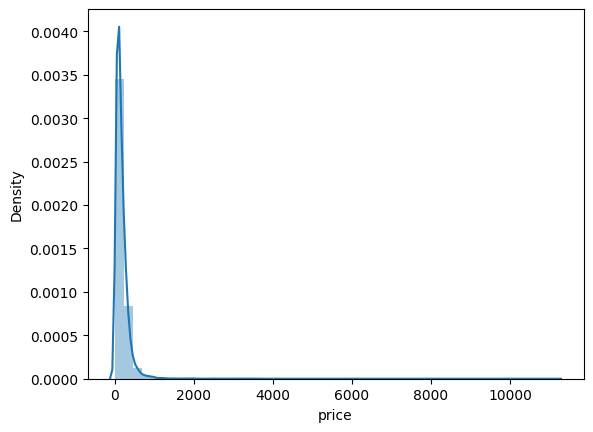

In [50]:
sns.distplot(df_explore['price'])

/tmp/ipython-input-51-2616869592.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log(df_explore['price']))


<Axes: xlabel='price', ylabel='Density'>

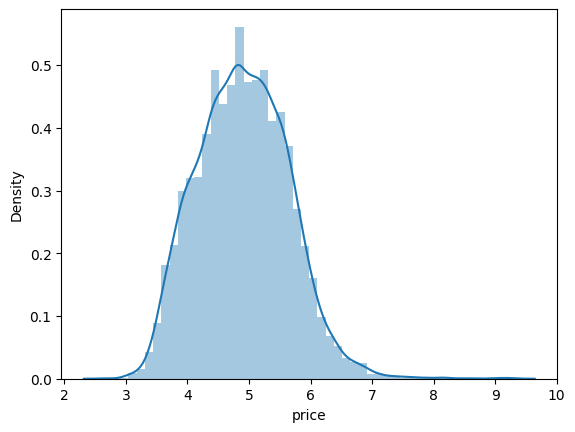

In [51]:
# Step 6 - transform output -- make a decision later depending on the type of model we're using
sns.distplot(np.log(df_explore['price']))

In [55]:
df_explore[cont_vars]

,host_response_rate,host_acceptance_rate,latitude,longitude,bathrooms,bedrooms,beds,review_scores_rating,reviews_per_month
2,90%,29%,43.64608,-79.390320,1.0,2.0,2.0,4.80,0.26
6,100%,NaN,43.74922,-79.291880,0.0,2.0,4.0,4.96,0.65
7,100%,40%,43.67193,-79.385900,1.0,1.0,1.0,4.18,0.37
8,100%,40%,43.66123,-79.383360,1.0,0.0,1.0,4.17,0.50
9,100%,40%,43.67180,-79.384880,1.0,1.0,1.0,4.40,0.13
...,...,...,...,...,...,...,...,...,...
21087,88%,25%,43.67123,-79.389380,1.0,1.0,2.0,NaN,NaN
21088,NaN,100%,43.65827,-79.373340,0.0,2.0,3.0,NaN,NaN
21089,100%,100%,43.64845,-79.393582,1.0,2.0,3.0,NaN,NaN
21090,100%,100%,43.75749,-79.442840,3.0,4.0,6.0,NaN,NaN


In [56]:
# Step 7 - clean up continuous data
def clean_continuous_columns(df, cont_vars):
    for col in cont_vars:
        # Check if column is object or string and has any values with '%'
        if df[col].dtype == 'object' and df[col].astype(str).str.contains('%').any():
            df[col] = df[col].str.rstrip('%').astype(float) / 100  # Convert to proportion
    return df


In [58]:
df_explore = clean_continuous_columns(df_explore, cont_vars)

In [60]:
df_explore[cont_vars].info()

<class 'pandas.core.frame.DataFrame'>
Index: 15365 entries, 2 to 21091
Data columns (total 9 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   host_response_rate    12964 non-null  float64
 1   host_acceptance_rate  13269 non-null  float64
 2   latitude              15365 non-null  float64
 3   longitude             15365 non-null  float64
 4   bathrooms             15357 non-null  float64
 5   bedrooms              15344 non-null  float64
 6   beds                  15352 non-null  float64
 7   review_scores_rating  12037 non-null  float64
 8   reviews_per_month     12037 non-null  float64
dtypes: float64(9)
memory usage: 1.2 MB


In [63]:
df_explore[disc_vars].info()

<class 'pandas.core.frame.DataFrame'>
Index: 15365 entries, 2 to 21091
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   host_listings_count        15359 non-null  float64
 1   host_total_listings_count  15359 non-null  float64
 2   accommodates               15365 non-null  int64  
 3   minimum_nights             15365 non-null  int64  
 4   maximum_nights             15365 non-null  int64  
 5   availability_30            15365 non-null  int64  
 6   availability_60            15365 non-null  int64  
 7   availability_90            15365 non-null  int64  
 8   availability_365           15365 non-null  int64  
 9   number_of_reviews          15365 non-null  int64  
dtypes: float64(2), int64(8)
memory usage: 1.3 MB


In [66]:
df_explore[cat_variables].info()

<class 'pandas.core.frame.DataFrame'>
Index: 15365 entries, 2 to 21091
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   host_location           11024 non-null  object
 1   host_response_time      12964 non-null  object
 2   host_is_superhost       14762 non-null  object
 3   host_neighbourhood      4306 non-null   object
 4   host_has_profile_pic    15359 non-null  object
 5   host_identity_verified  15359 non-null  object
 6   neighbourhood_cleansed  15365 non-null  object
 7   property_type           15365 non-null  object
 8   room_type               15365 non-null  object
 9   has_availability        15177 non-null  object
 10  license                 8737 non-null   object
 11  instant_bookable        15365 non-null  object
dtypes: object(12)
memory usage: 1.5+ MB


In [70]:
df_explore[cat_variables].head()


,host_location,host_response_time,host_is_superhost,host_neighbourhood,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,property_type,room_type,has_availability,instant_bookable
2,NaN,within a day,t,Entertainment District,t,t,Waterfront Communities-The Island,Entire condo,Entire home/apt,t,f
6,"Toronto, Canada",within a day,f,Wexford/Maryvale,t,f,Wexford/Maryvale,Entire bungalow,Entire home/apt,t,f
7,"Toronto, Canada",within a few hours,f,Rosedale,t,t,Rosedale-Moore Park,Entire rental unit,Entire home/apt,t,f
8,"Toronto, Canada",within a few hours,f,Rosedale,t,t,Bay Street Corridor,Entire condo,Entire home/apt,t,f
9,"Toronto, Canada",within a few hours,f,Rosedale,t,t,Rosedale-Moore Park,Private room in rental unit,Private room,t,f


In [71]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_scatter_relationships(df, features, target='price'):
    for feature in features:
        plt.figure(figsize=(6, 4))
        sns.scatterplot(data=df, x=feature, y=target, alpha=0.5)
        plt.title(f'{feature} vs. {target}')
        plt.xlabel(feature)
        plt.ylabel(target)
        plt.grid(True)
        plt.tight_layout()
        plt.show()


In [72]:
def plot_boxplots(df, categorical_features, target='price'):
    for feature in categorical_features:
        plt.figure(figsize=(8, 4))
        sns.boxplot(data=df, x=feature, y=target)
        plt.title(f'{feature} vs. {target}')
        plt.xlabel(feature)
        plt.ylabel(target)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()


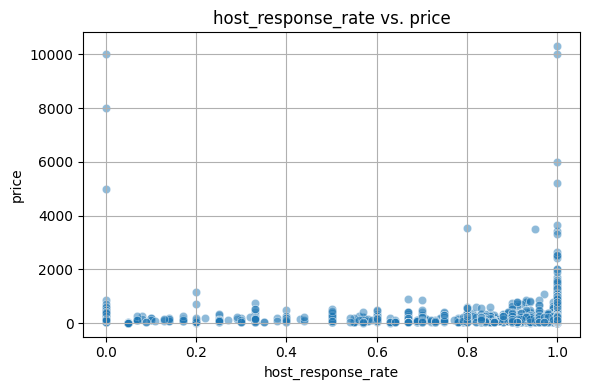

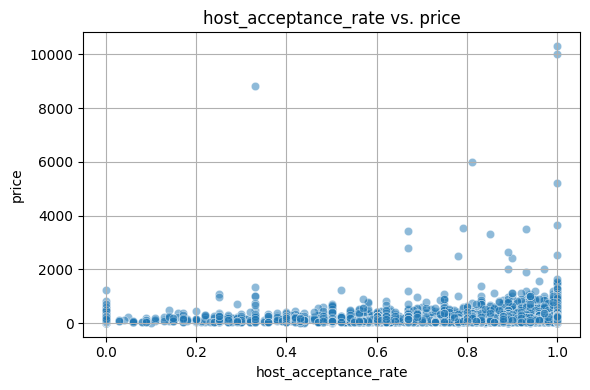

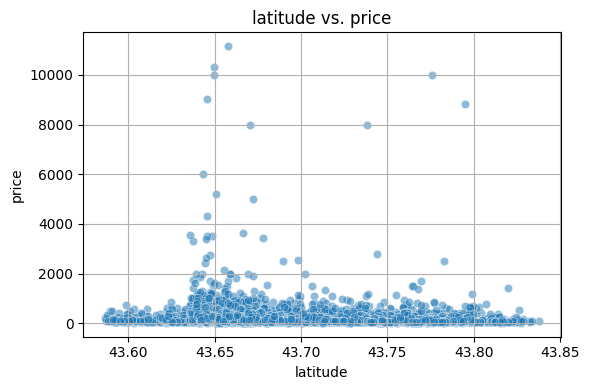

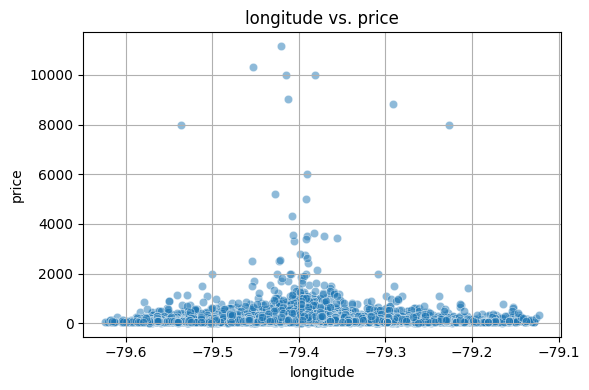

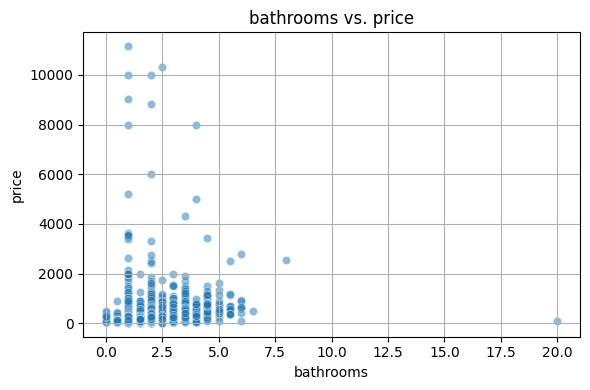

...

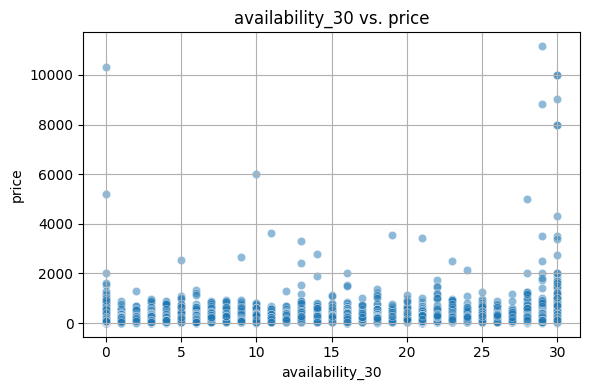

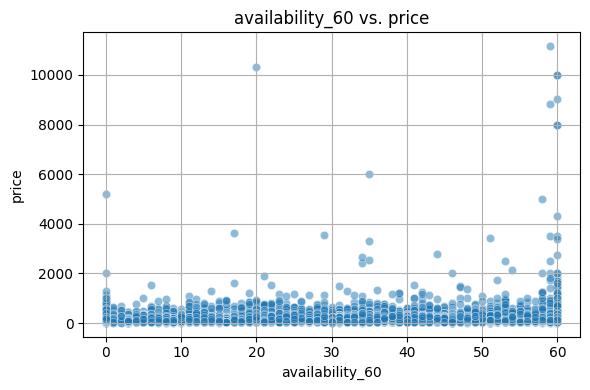

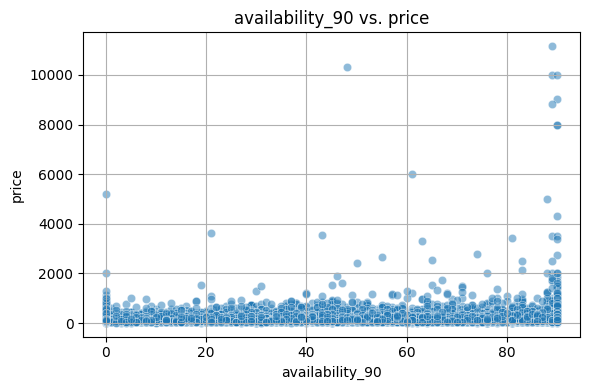

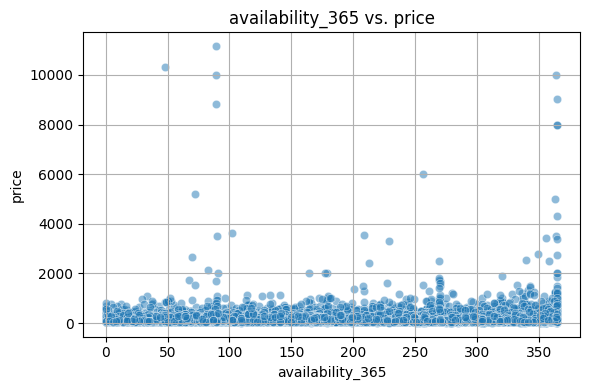

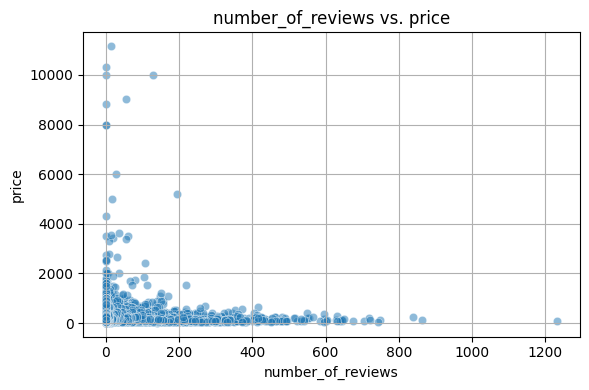

In [73]:
plot_scatter_relationships(df_explore, cont_vars + disc_vars, target='price')

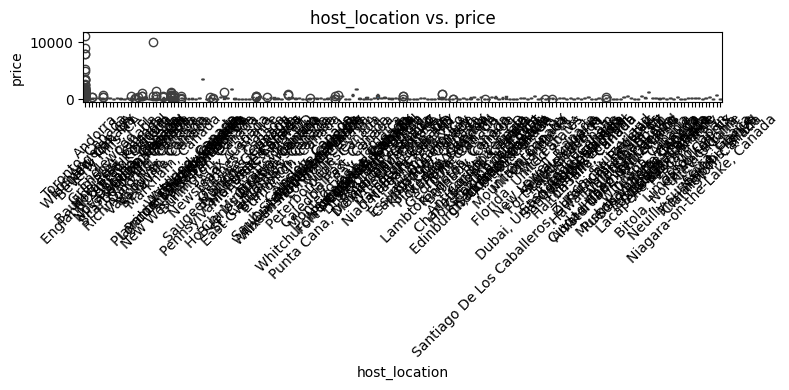

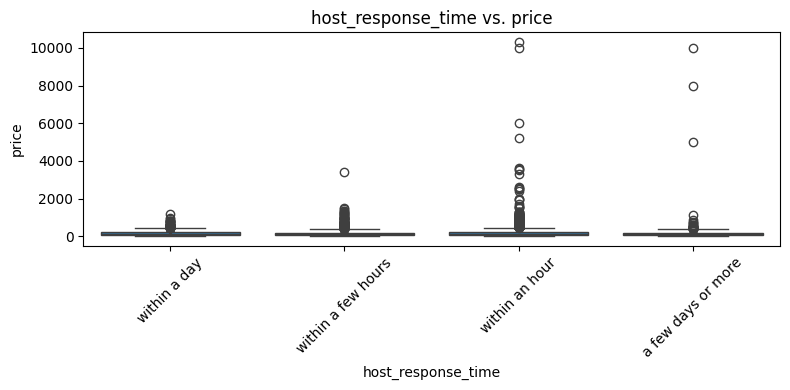

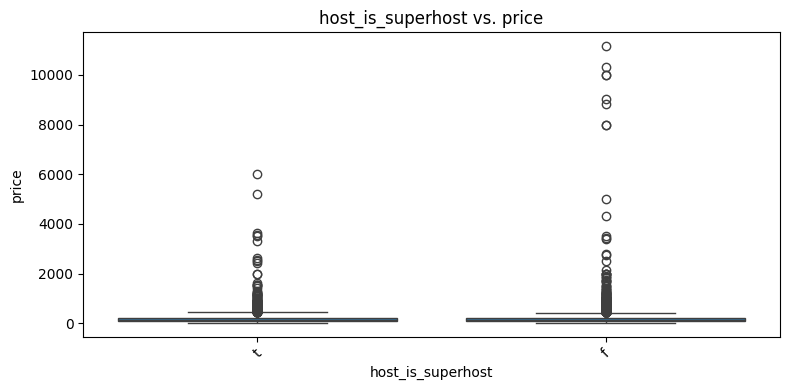

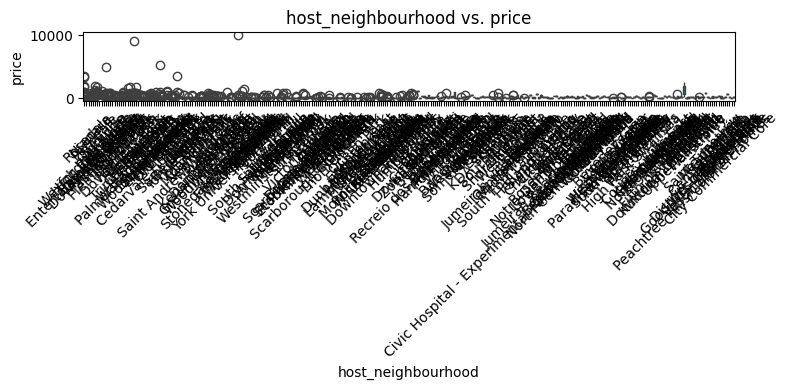

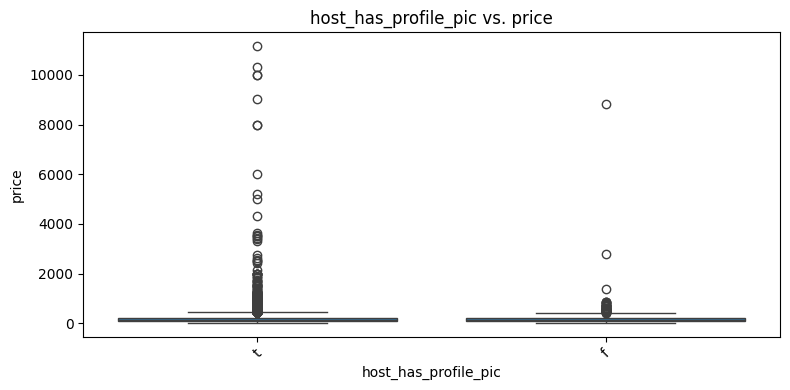

...

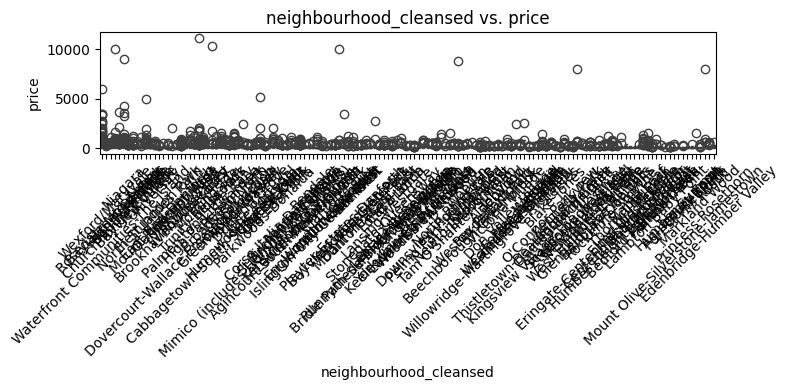

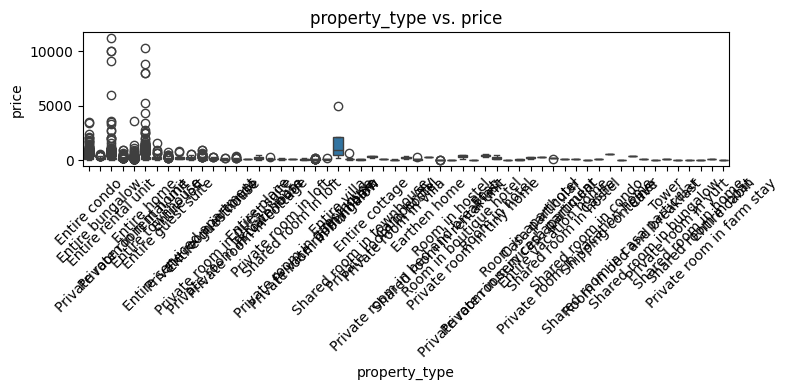

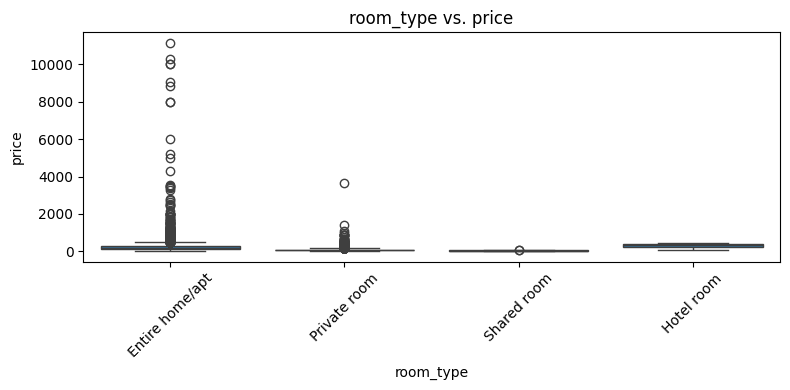

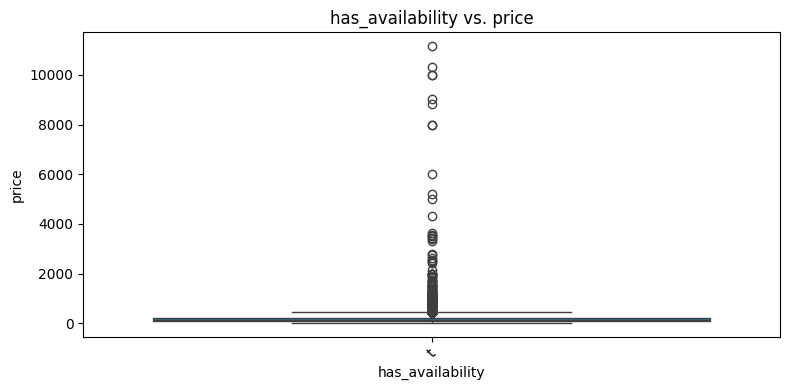

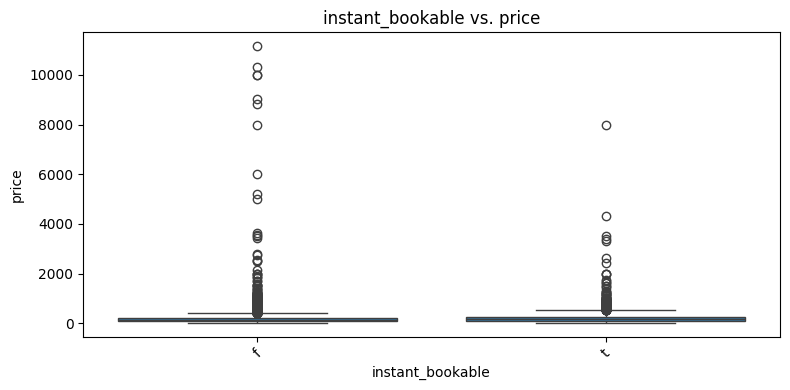

In [75]:
plot_boxplots(df_explore, cat_variables, target='price')

In [78]:
df_explore['has_availability'].value_counts()

,count
has_availability,
t,15177


In [80]:
df_explore

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,availability_eoy,number_of_reviews_ly,estimated_occupancy_l365d,estimated_revenue_l365d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
2,26654,https://www.airbnb.com/rooms/26654,20250609011800,2025-06-18,city scrape,"World Class @ CN Tower, convention centre, The...","CN Tower, TIFF Bell Lightbox, Metro Convention...",There's a reason they call it the Entertainmen...,https://a0.muscache.com/pictures/81811785/5dcd...,113345,https://www.airbnb.com/users/show/113345,Adela,2010-04-25,NaN,Welcome to Toronto! \r\n\r\nAfter our first me...,within a day,0.90,0.29,t,https://a0.muscache.com/im/users/113345/profil...,https://a0.muscache.com/im/users/113345/profil...,Entertainment District,4.0,10.0,"['email', 'phone', 'work_email']",t,t,Neighborhood highlights,Waterfront Communities-The Island,43.64608,-79.390320,Entire condo,Entire home/apt,4,1.0,1 bath,2.0,2.0,"[""Wine glasses"", ""Shared sauna"", ""Paid parking...",158.0,28,1125,28,28,1125,1125,28.0,1125.0,t,18,48,78,168,2025-06-18,45,3,0,168,2,168,26544.0,2011-01-05,2025-02-01,4.80,4.80,4.80,4.67,4.78,4.87,4.69,NaN,f,4,4,0,0,0.26
6,43964,https://www.airbnb.com/rooms/43964,20250609011800,2025-06-17,city scrape,Cozy & Private Basement Apartment free parking,Cozy 2-Bedroom Basement Suite in Wexford-Maryv...,- Super quiet family-friendly neighborhood<br ...,https://a0.muscache.com/pictures/5ce26405-6792...,192364,https://www.airbnb.com/users/show/192364,Mitra,2010-08-05,"Toronto, Canada",Love to meet people from all over the world by...,within a day,1.00,NaN,f,https://a0.muscache.com/im/pictures/user/9052c...,https://a0.muscache.com/im/pictures/user/9052c...,Wexford/Maryvale,1.0,1.0,"['email', 'phone']",t,f,Neighborhood highlights,Wexford/Maryvale,43.74922,-79.291880,Entire bungalow,Entire home/apt,4,0.0,0 baths,2.0,4.0,"[""Lockbox"", ""Drying rack for clothing"", ""Wine ...",143.0,2,31,2,2,31,31,2.0,31.0,t,28,58,88,286,2025-06-17,67,0,0,196,0,0,0.0,2017-01-04,2023-09-25,4.96,4.96,4.99,4.99,4.97,4.85,4.88,STR-2012-FMQPHC,f,1,1,0,0,0.65
7,44452,https://www.airbnb.com/rooms/44452,20250609011800,2025-06-18,city scrape,Yonge & Bloor Studio Skyline,NaN,NaN,https://a0.muscache.com/pictures/395bd5b5-795a...,195095,https://www.airbnb.com/users/show/195095,Urbano,2010-08-08,"Toronto, Canada",Boutique property management firm located in T...,within a few hours,1.00,0.40,f,https://a0.muscache.com/im/users/195095/profil...,https://a0.muscache.com/im/users/195095/profil...,Rosedale,11.0,19.0,"['email', 'phone']",t,t,NaN,Rosedale-Moore Park,43.67193,-79.385900,Entire rental unit,Entire home/apt,2,1.0,1 bath,1.0,1.0,"[""Wifi"", ""Kitchen"", ""Hot water"", ""Free street ...",94.0,28,720,28,28,720,720,28.0,720.0,t,0,0,13,288,2025-06-18,67,1,0,120,1,56,5264.0,2010-10-04,2024-07-10,4.18,4.51,4.03,4.

In [85]:
def add_amenity_indicators(df, amenity_col, top_amenities):
    for amenity in top_amenities:
        col_name = f'has_{amenity.lower().replace(" ", "_")}'
        df[col_name] = df[amenity_col].str.contains(amenity, case=False, na=False).astype(int)
    return df

In [83]:
# Step 8 - transform the dataset to look for top amenities
top_amenities = [
    'Smoke alarm',
    'Kitchen',
    'Wifi',
    'Carbon monoxide alarm',
    'Hot water'
]

df_explore = add_amenity_indicators(df_explore, 'amenities', top_amenities)

In [87]:
df_explore.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bathrooms', 'bathrooms_text', 'bedrooms',
       'beds', 'amenities', 'price', 'minimum_nights', 'maximum_nights',
       'minimum_minimum_nights', 'maximum_minimum_nights',
       'minimum_maximum_nights', 'maximum_maximum_nights',
       'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'has_availability',
       'availability_3

In [86]:
dep = ['price']

cat_variables = ['host_location','host_response_time','host_is_superhost', 'host_neighbourhood','host_has_profile_pic','host_identity_verified','neighbourhood_cleansed','property_type','room_type','instant_bookable','has_smoke_alarm', 'has_kitchen', 'has_wifi', 'has_carbon_monoxide_alarm', 'has_hot_water']

cont_vars = ['host_response_rate','host_acceptance_rate', 'latitude','longitude','bathrooms','bedrooms','beds','review_scores_rating', 'reviews_per_month']

disc_vars = ['host_listings_count','host_total_listings_count','accommodates','minimum_nights','maximum_nights','availability_30','availability_60', 'availability_90','availability_365','number_of_reviews']

In [88]:
y = df_explore[dep]
X = df_explore[cat_variables + cont_vars + disc_vars]

In [89]:
from sklearn.model_selection import train_test_split

In [153]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [154]:
X_train = pd.concat([X_train, X.loc[[269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,
        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,
       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704]]], axis=0)

In [155]:
y_train = pd.concat([y_train, y.loc[[269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,
        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,
       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704]]], axis=0)

In [156]:
X_test.drop([269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,
        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,
       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704], inplace=True)
y_test.drop([269,  1131,  2256,  3637,  3704,  4926,  5721,  6444,  6555,  8205,
        9239,  9379, 10944, 12997, 15386, 17537, 17570, 18244, 19526, 3156,  3903,  4976,  7232,  7278,  7501,  8418,  8455,  8700,  8817,
       11093, 11779, 12094, 12323, 13215, 15863, 20431,195, 10427, 20704], inplace=True)

In [157]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer


In [158]:
catimp = SimpleImputer(strategy='most_frequent')
numimp = SimpleImputer(strategy='constant', fill_value=0)
discimp = SimpleImputer(strategy='median')


In [159]:
X_train[cat_variables] = catimp.fit_transform(X_train[cat_variables])

In [160]:
X_train[cont_vars] = numimp.fit_transform(X_train[cont_vars])

In [161]:
X_train[disc_vars] = discimp.fit_transform(X_train[disc_vars])

In [162]:
encoder = OneHotEncoder(sparse_output=False, drop='first')
X_encoded = encoder.fit_transform(X_train[cat_variables])

In [163]:
X_encoded

array([[0., 0., 0., ..., 1., 1., 1.],
       [0., 0., 0., ..., 1., 1., 1.],
       [0., 0., 0., ..., 1., 1., 1.],
       ...,
       [0., 0., 0., ..., 1., 1., 1.],
       [0., 0., 0., ..., 1., 1., 0.],
       [0., 0., 0., ..., 1., 1., 1.]])

In [164]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train[cont_vars + disc_vars])

In [165]:
X_final = np.concatenate((X_encoded, X_scaled), axis=1)

In [166]:
X_train = X_final.copy()

In [167]:
# Transforming the TEST data
X_test[cat_variables] = catimp.transform(X_test[cat_variables])
X_test[cont_vars] = numimp.transform(X_test[cont_vars])
X_test[disc_vars] = discimp.transform(X_test[disc_vars])

In [168]:
X_test_encoded = encoder.transform(X_test[cat_variables])

In [169]:
X_test_scaled = scaler.transform(X_test[cont_vars + disc_vars])

In [170]:
X_test_final = np.concatenate((X_test_encoded, X_test_scaled), axis=1)

In [171]:
X_test = X_test_final.copy()

In [152]:
# Checking Function
df_explore[df_explore['property_type'].isin(['Castle', 'Entire cabin', 'Private room in cottage'])].index

Index([195, 10427, 20704], dtype='int64')

In [172]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error, r2_score


In [173]:
lr = LinearRegression()

In [174]:
scores = cross_val_score(lr, X_train, y_train, cv=5, scoring='neg_mean_squared_error')

In [179]:
#avg square root error for the linear regression model
np.mean(np.sqrt(np.abs(scores)))

np.float64(266.68225074236585)

In [182]:
y_test.mean()

,0
price,177.927818


In [183]:
from sklearn.neighbors import KNeighborsRegressor
knn = KNeighborsRegressor()
scores_knn = cross_val_score(knn, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
np.mean(np.sqrt(np.abs(scores_knn)))


np.float64(272.1389951519799)